This notebook is a collection of my (Reagan H.) notes on the basics of machine learning. AI is quite big these days and I wanted to refresh my memory.

First, we will discuss the theory. Let's begin with the perceptron. The idea of a perceptron is to take some inputs (x1,x2,...) and produce some binary output (the decision, f). Each input is multiplied by a weight, and all of these values are summed. The sum of these values are compared to a threshold, or bias, and then the output is determined from that. See example image:

# Perceptron

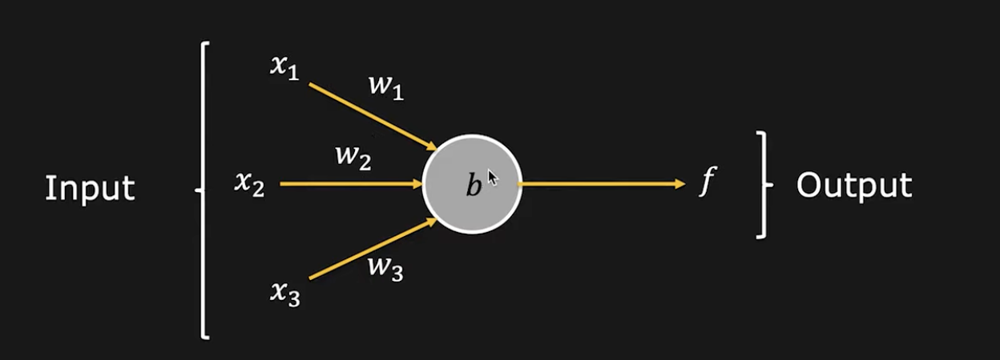

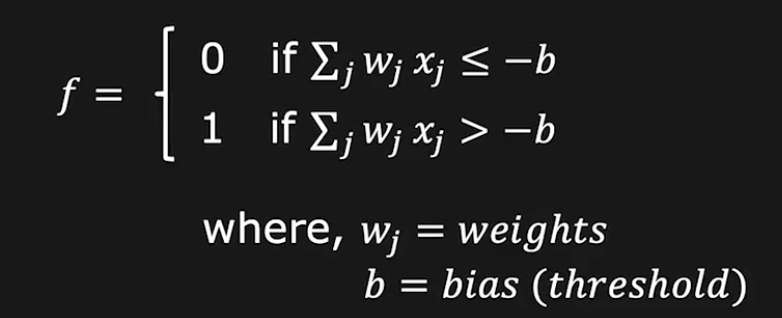

The formula above can be rewritten in simple terms: for each input, if *(x)(w) + b <= 0, return 0. if (x)(w) + b > 0, return 1*. Seems simple enough, here's a python function that performs that operation when given input value, weight value, and bias value:

In [2]:
def onePerceptronInput(x,w,b):
    if (x*w) + b <= 0:
      return 0
    else:
      return 1

print("Here are some made up values to demonstrate (x = 2.5, w = 0.1, b = 0.5):")
print("Decision =", onePerceptronInput(2.5, 0.1, 0.5))

Here are some made up values to demonstrate (x = 2.5, w = 0.1, b = 0.5):
Decision = 1


The expression *(x)(w) + b* represents a step-function or Heaviside function. It will always output a 0 until some point triggers, or activates, it to jump to output a 1.

heaviside.svg

Let's use a real-world example. The decision to be made is: "Will I go out to eat?" There are three factors, or inputs, that alter this decision. 1) Is the weather good? 2) Do I have no food at home? 3) Do I have company to join me? These will be our x's, and they will take values of 0 or 1. Let's assume the most important factor, to you, is having food at home. This one will likely have a higher weight than the other two, let's say a weight of 3 while the other factors have a weight of 2. Now let's say you typically go out to eat if you have food at home and any of the other factors are also true. This causes us to choose a bias of -4, since the weight of having food at home is 4 and the other's are weights of 2. See below for an example of x2 and x3 (no food at home and company are true):

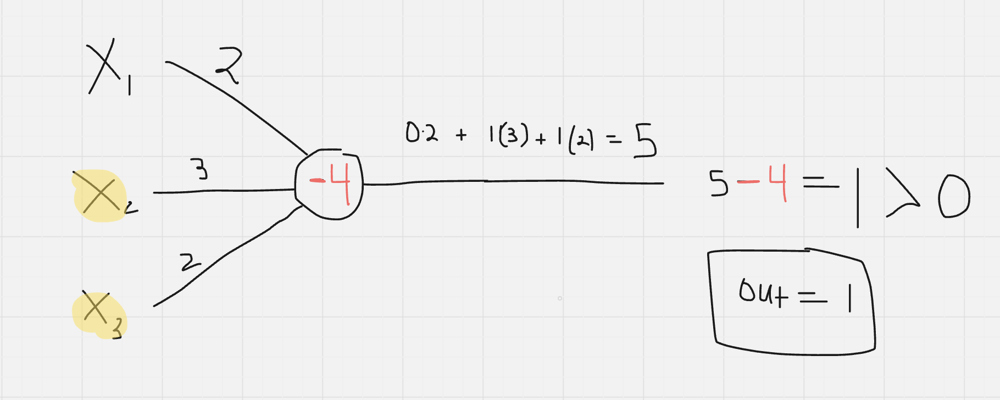

Here, we see how the output is "yes", or 1, because of our defined weights and inputs. Ok, so that seems simple enough as well, we can probably do some Python to program this in for however many inputs and weights we have:

In [3]:
inputs = [0,1,1]
weights = [2,3,2]
bias = -4
# note that weights and inputs need to be the same length, here we are hard coding them in.
length = len(inputs)
result = 0

for i in range(length):
  result = result + (inputs[i] * weights[i])

if (result + bias) > 0:
  print("Decision = 1")
else:
  print("Decision = 0")

Decision = 1


Keen math enthusiasts will want to see some graphs. Let's make a new perceptron with just 2 inputs: x and y. The weights are both -2 and the bias is 3 (made up numbers shown in the textbook example). Sketching this out, we can define a function and graph it based on these rules. For the algebra inclined folks, you may see how bias corresponds to the y-intercept, and slope corresponds to weights (so you can construct your own parameters for other desired decision boundaries):

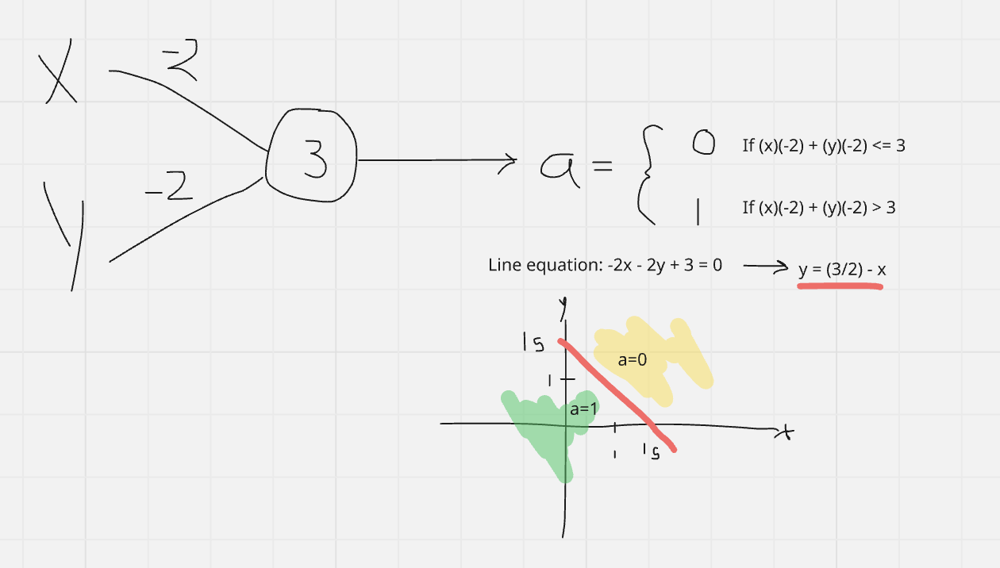

*Note that the graph intercetps looks like 15, it's 1.5, my decimal is too small*. This is why perceptrons are called a linear classifiers. The green side of the decision boundary line represents the values where the perceptron activates (decision = 1) and the yellow side is the opposite. Consider our x and y inputs to this perceptron are only able to be binary; 0 or 1.

We can make a simple truth table that shows how the perceptron's activation output, a, behaves based on x and y's possible values:

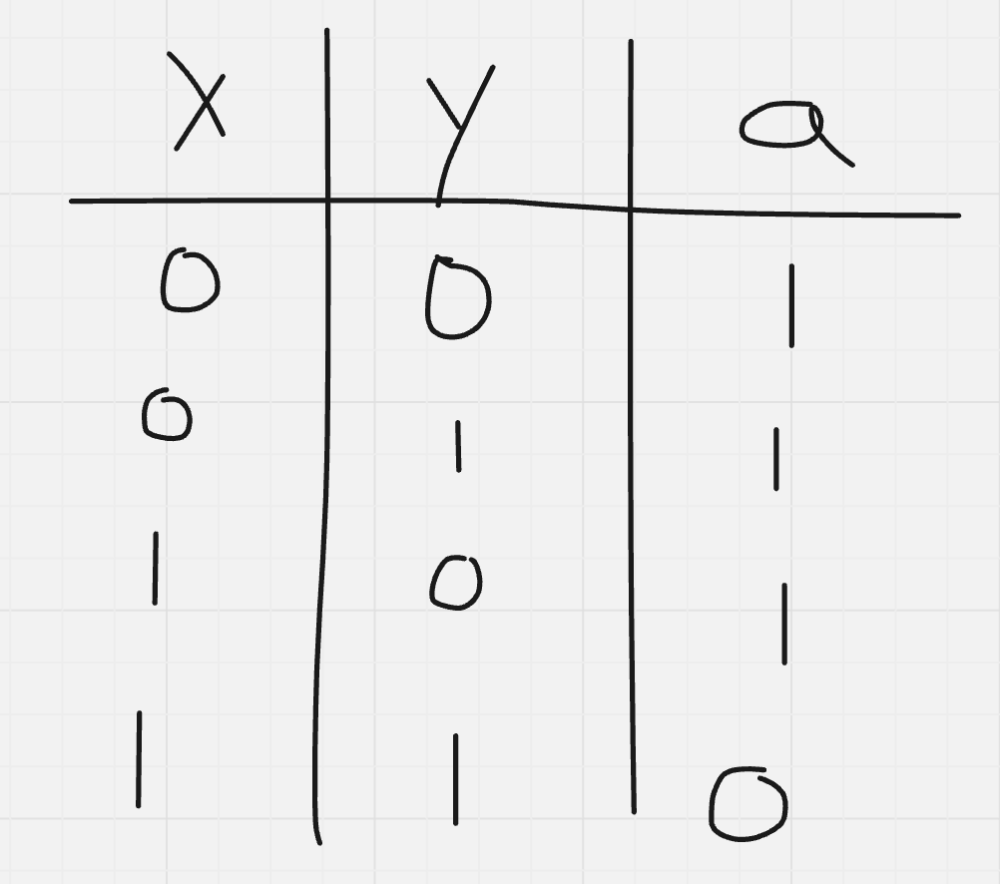

Circuit people recognize this as the truth table for a NAND gate, a basic and fundamental circuit component. Any digital circuit (dealing with 1's and 0's - high and low voltages) can be built from NAND gates. Now we see how a perceptron can behave the same way. I won't dive into the theory of digital logic, but there is a key point to all these examples: **Perceptrons are universal for computation.** Let's move onto how multiple perceptrons can be hooked together to perform said computations...

# Neural Networks

I am going to steal some slides from a great lecture on this topic [you can see here](https://www.youtube.com/watch?v=torNuKNLwBE), since they provide better visuals than I can with my whiteboard app. First, let's look at the graph provided. You see there are yellow circles and red triangles. The idea is to try and come up with a way to have a group of perceptrons figure out if a coordinate for an input (x1 and x2 in this case) is a circle or triangle:

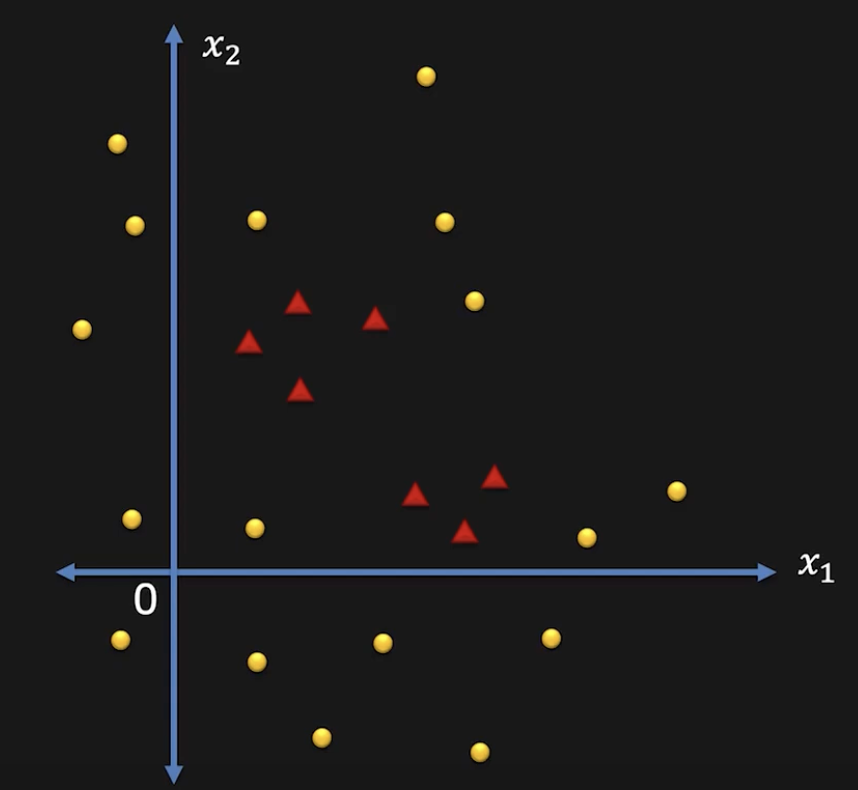

Next, our network of perceptrons will look like the image below, we have x1 and x2 as inputs, some number of perceptrons in a layer, and one last perceptron to produce the final binary output of 0 or 1 activation. Remembering how above we said perceptrons are *linear classifiers*, this means we can group up multiple perceptrons with various weights and biases to essentially draw multiple boundary lines on our graph and construct a region around the features we want to classify.

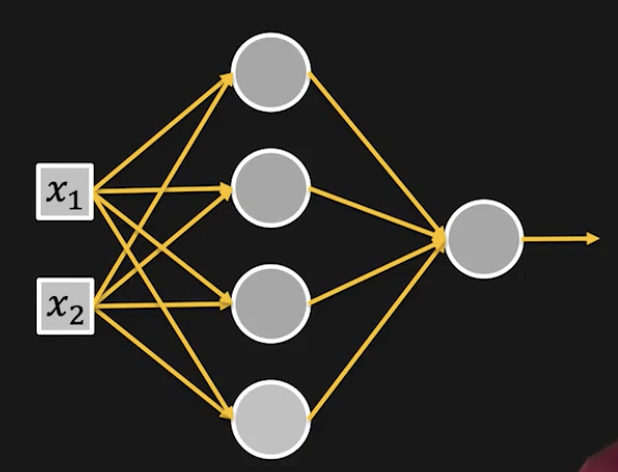

So in the network we see four different perceptrons all with x1 and x2 as inputs, then those all combine into one final perceptron to produce the output. Each of these will be configured to draw a "decision boundary" on the graph as shown in the images below:

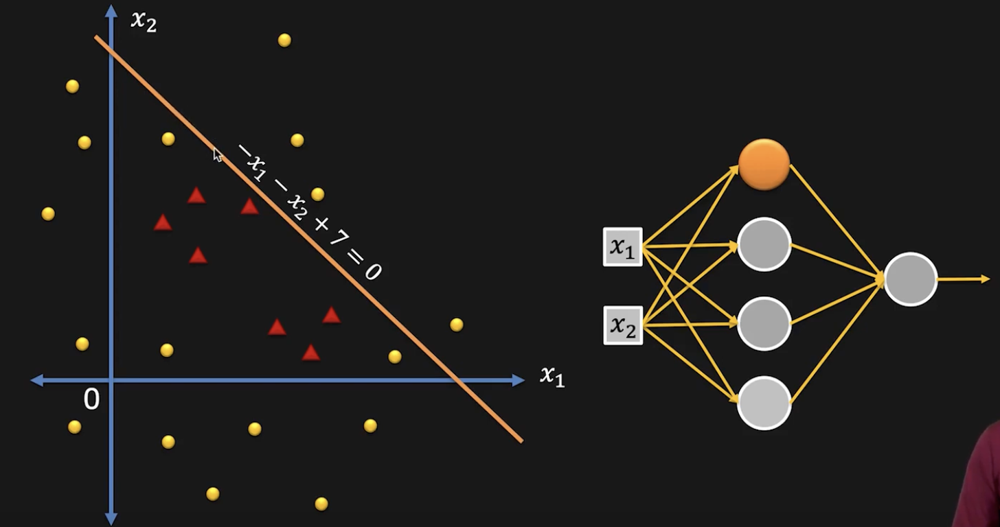

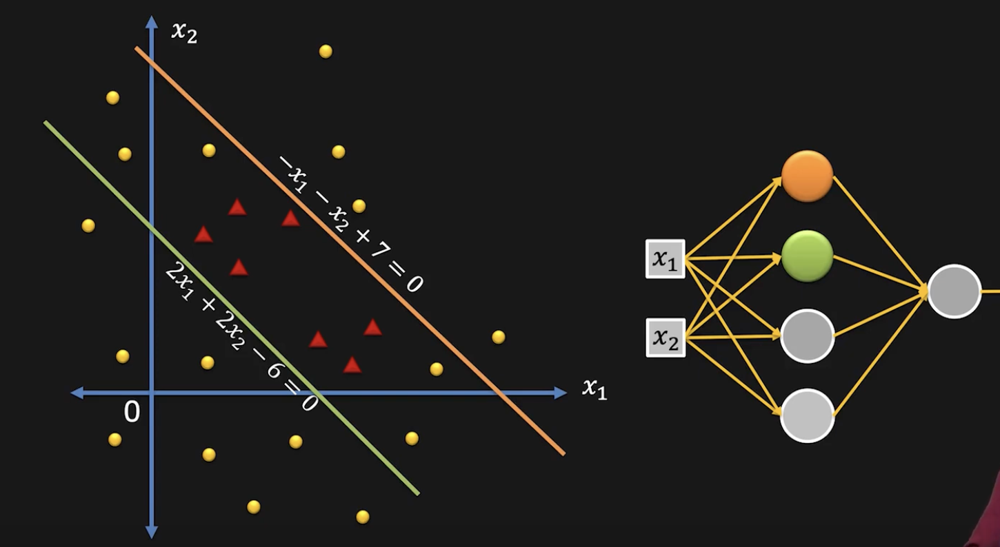

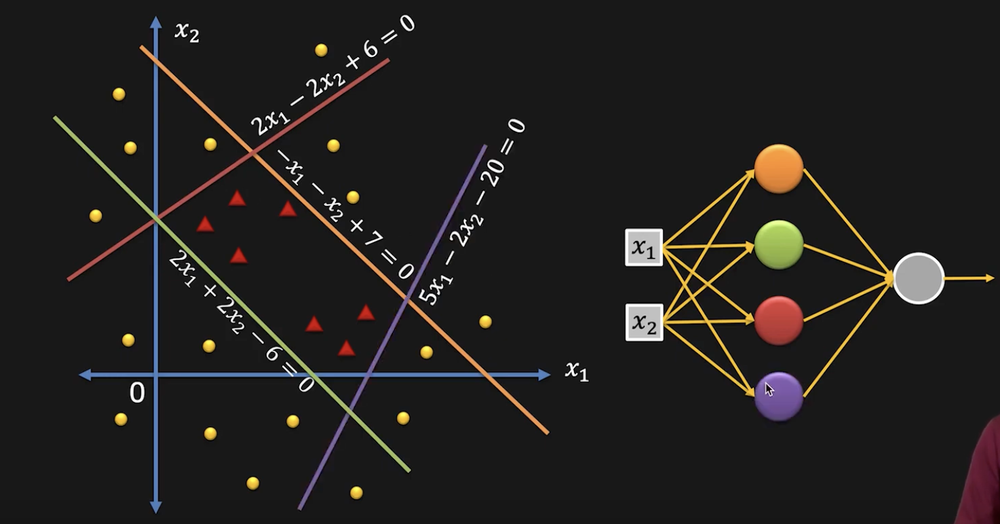

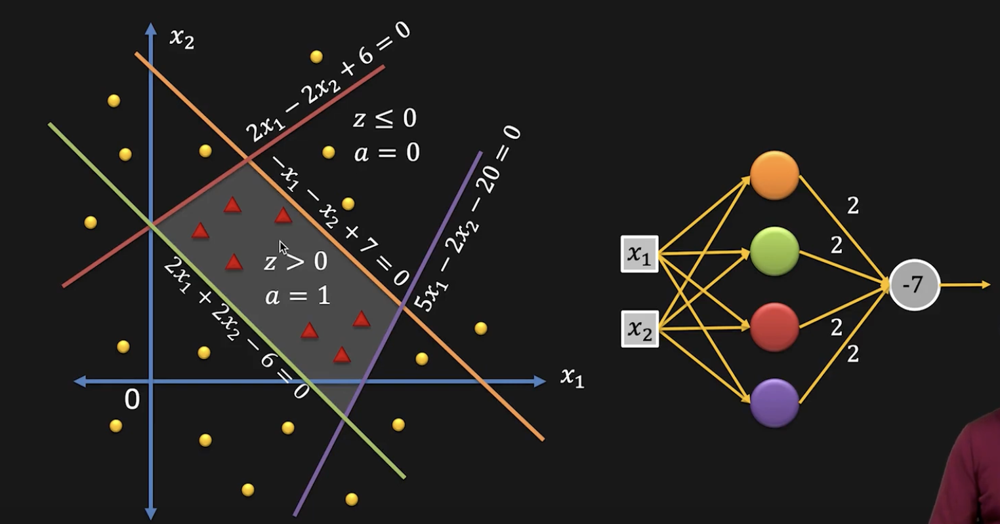

After throwing some actual values on these lines (which are just made up for the example but with real data you would find these based on where the red triangles are) we see the weights and biases for each perceptron.


*   Orange: weights = -1, bias = 7
*   Green: weights = 2, bias = -6
*   Red: weights = 2 & -2, bias = -6
*   Purple: weights = 5 & -2, bias = -20

You'll get a "1" for each perceptron only for points lying in the shaded region. That means the output perceptron will be configured to only output "1" when all other perceptrons are also "1" (so in this example, each weight for the final perceptron is 2 and the bias is -7 in order to get that behavior. You can also use other weights and bias if needed like 1 and -3 for example).

Now you can see how complexity can explode in this. There can be many more inputs, resulting in higher dimension graphs; many more perceptron layers; etc. etc.

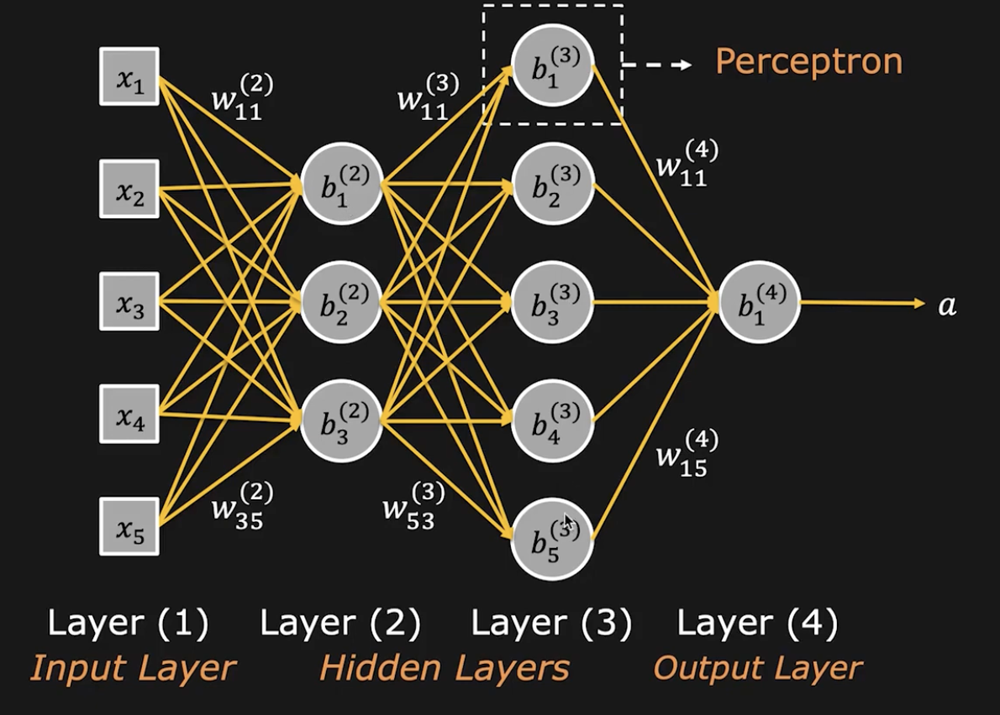

Example above is for a "fully connected" network, where each input is connected to all of the perceptrons in the next layer, but that is not always the case. There's one single output here, but that also is not necessary, it all depends on the use.

# Adjusting Neural Networks

Now let's consider adjusting a neural network. Rudimentarily we see how we can connect however many neurons we need to "box in" our desired classifiers. The weights and biases chosen will very likely be imperfect on the first go, thus requiring adjustment. Or perhaps we have no idea where to set our weights and biases to begin with! Adjusting those values by a small amount will adjust the output by a small amount. Over time you can adjust these up or down (like turning a bunch of knobs) until the output is what you desire based on a given input. However, this is tough to do. Look back at the step-function above, the output is either a 0 or a 1 depending on if the inputs summed together are negative or positive. Say we add in some input, we expect a 1 to be output for the decision, but instead a 0. Now we must adjust the network weights and biases and try to get our input sums closer to positive so the output gets to 1. But with the step function, the output will just at some point switch, adjusting anything is blind.

In order to get some feedback, the activation function of a neuron needs to be adjusted. This is where the Sigmoid* Neuron comes into play. In the photo below, you'll see how if we use the fraction to define our activation function, the graph is *close* to the step function, but a smooth ramp rather than harsh flip. This allows us to adjust the weights and biases and see the output changing (by going up/down the curve or remaining stationary). Again, [this video](https://www.youtube.com/watch?v=_ETavTWv3ok) animates it nicely.

*Note: the Sigmoid function is one of many that look similar to the step function "smoothed out". It's just a commonly used one in textbooks.

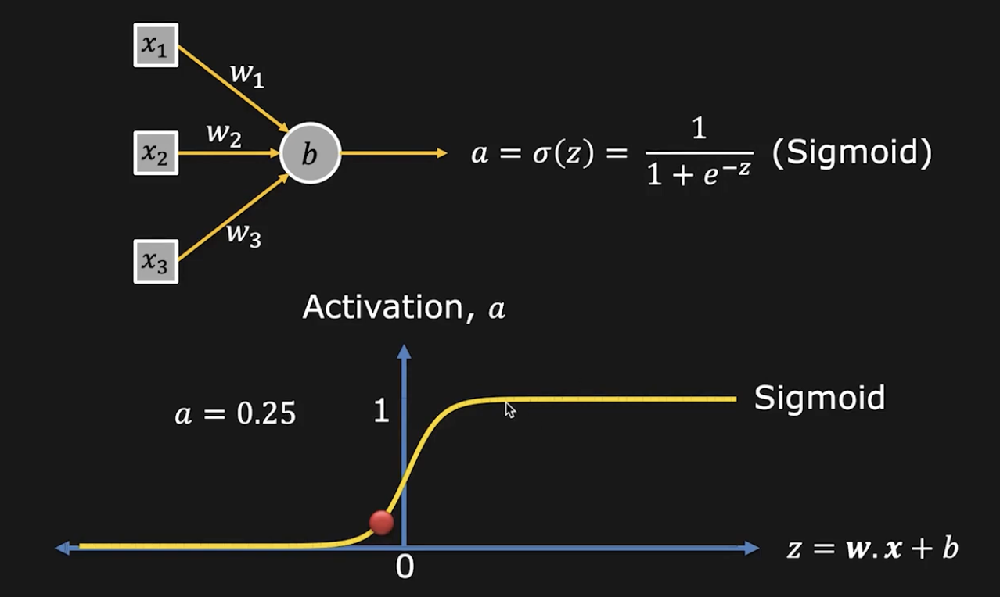

So now, as adjustments are made, our output will slightly change and we can tell which way the adjustments are going:

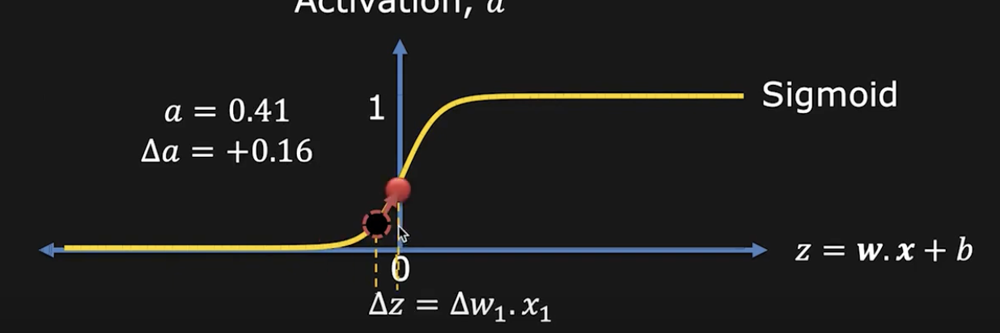

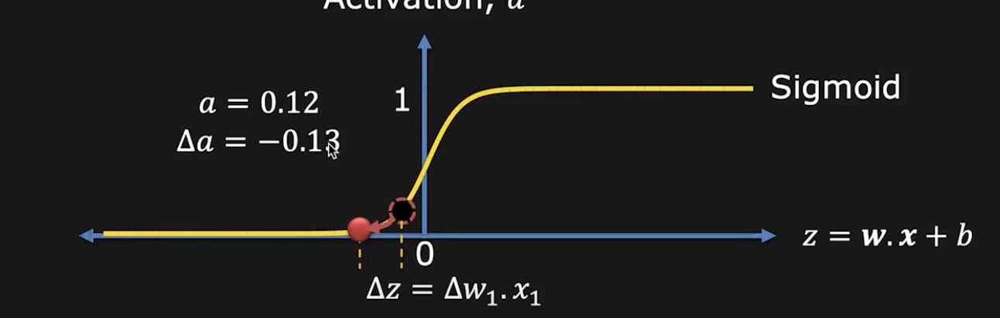

In [4]:
# Sigmoid Neuron Example code:
# random numbers here, play with these and see how output changes!
inputs = [1,2,3]
weights = [1,1,1]
bias = -5
sums = 0
z = 0
a = 0

for i in range(length):
  sums = sums + (inputs[i] * weights[i])

z = sums + bias

# Sigmoid function
e = 2.71828 # rounding here but you can use math.e library for more decimals
a = 1 / (1 + e**(-z))

print("a =", a)

a = 0.731058446378433


In [5]:
# Sigmoid Neuron Example code with slightly modified weights and bias:
# random numbers here, play with these and see how output changes!
inputs = [1,2,3]
weights = [1.1,0.9,1]
bias = -5.5
sums = 0
z = 0
a = 0

for i in range(length):
  sums = sums + (inputs[i] * weights[i])

z = sums + bias

# Sigmoid function
e = 2.71828 # rounding here but you can use math.e library for more decimals
a = 1 / (1 + e**(-z))

print("a =", a)

a = 0.598687595467633


As you can see, the output changed a good bit when we adjusted some of the weights and bias (in practice, you would want to adjust one at a time so you get a clear idea of how it impacts the final output. This is also for one single neuron but the idea is to examine adjustments.

# Cost

So a neural network is a collection of perceptrons or Sigmoid neurons with an input layer, some number of hidden layers, and some number of outputs. It can be fully connected where all neurons in each layer connect to each other, or not fully connected. Constructing a neural network depends on the task you're trying to solve, and training the network requires finding proper weights and biases. The "hello world" of machine learning is the MNIST database of handwritten digits: a collection of images 28x28 pixels that have hand written numbers 0-9.

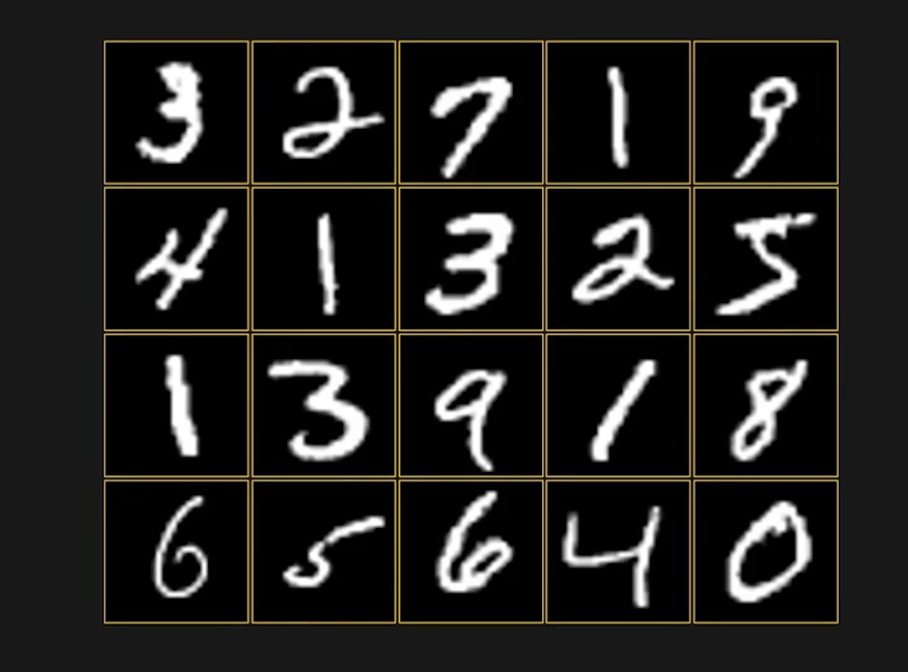

So for this task, the neural network must take in the pixel data of the numbers, perform some magic, and output a "1" based on what digit it thinks was input. So the input will be 784 (28 x 28) 0's or 1's (representing each pixel being white or black), and there will be 10 outputs (one for each digit 0-9).

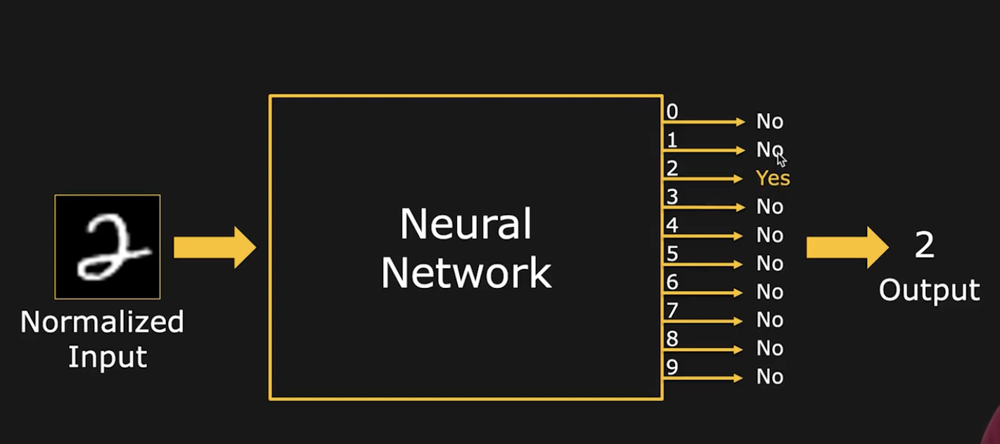

There's a ton of ways to construct the network, mainly relating to the number of hidden layers and how many neurons to put in each layer, but one guy (Nielson) created a model that has only one hidden layer, 30 neurons in it, and it provides 95% accuracy given the MNIST data of a ton of these handwritten digits. Very impressive for a hard problem like this one.

If we start with a network with random weights and biases (since we don't really know where to start), the results will be awful. That is where training comes in. Training data will contain the images needed to train, plus a label for what digit it is, as well as a desired activation output. The more the better. MNIST gives 60,000.

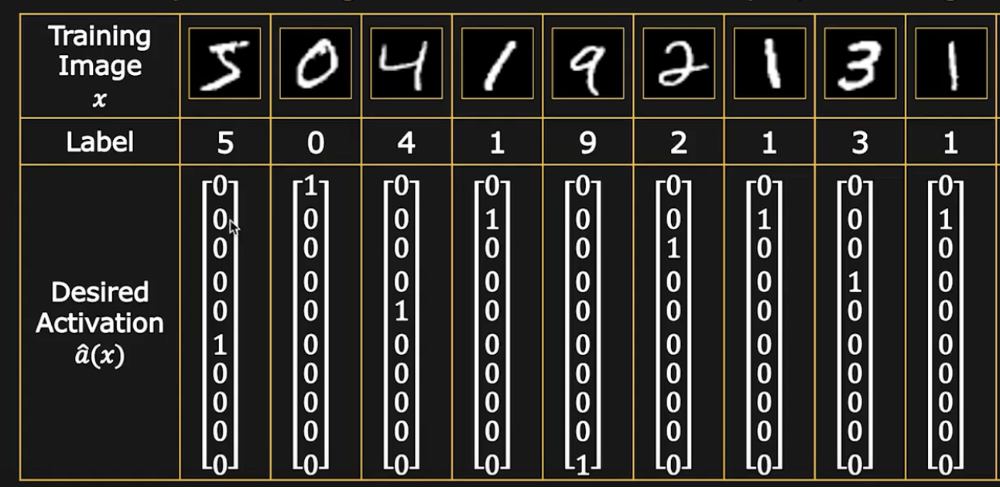

1) Randomize weights and biases of network

2) Throw in the training image and see what the activation is

3) Compute the cost* (how far off we were from desired activation)

4) Update weights and biases with gradient descent (more on that coming up).

5) Repeat until cost is acceptable and your network is doing what you need it to.

6) Plug in new data and let the network classify it for you.

*Cost is calculated by finding the Euclidian distance between the desired activation and the actual activation. This is where it's nice to have a linear algebra background. In the image below, focus on the right side for the cost of one training image based on some random weights and biases.

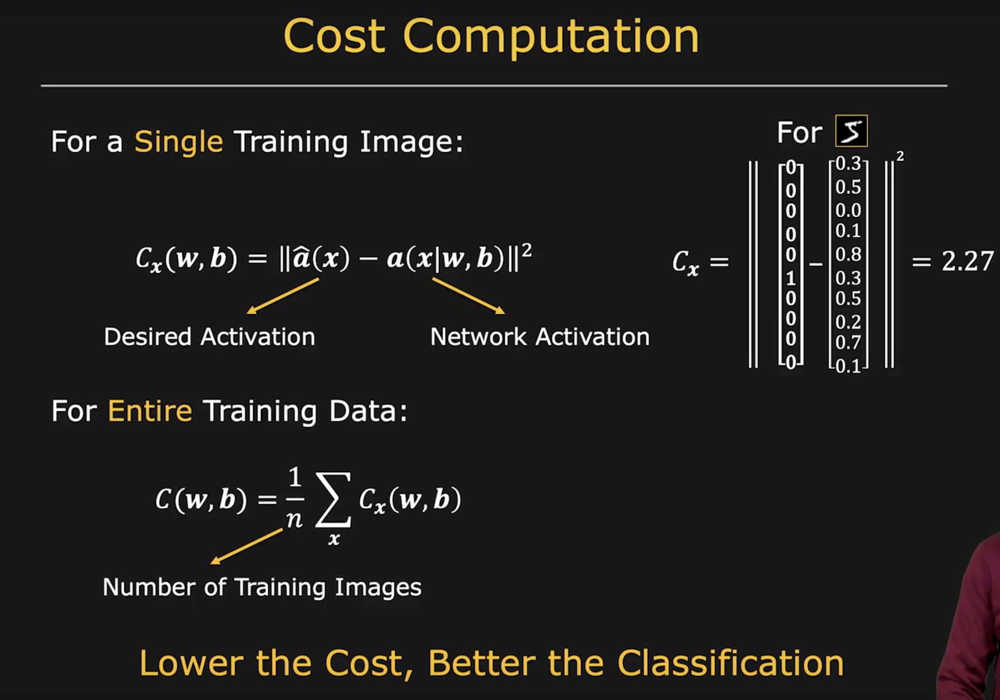

By the end of training, the actual network activation should be close to (but not perfect to) the desired activation matrix. Ex: input is an image of a "2", so the output may be: [0.1, 0, 0.98, 0.3, 0.1,...] and clearly the highest value is the third entry, representing a 2 (since 0 is first).

***Multi-varible calculus warning***. We are diving into gradient descent now, an optimization algorithm used to minimize a function (cost function in this case) by iteratively adjusting parameters (weights and biases in this case). A calculus background is encouraged but I will try to keep it simple here. Similar to the Sigmoid function, gradient descent is a widely used algorithm in machine learning but there are definetly others out there that could likely work as well.

So there exists some minimum cost for a neuron, based on weight and bias. Think of 3D space with length as weight, depth as bias, and height as cost. We also have some initial cost, randomly found with random weights and biases:

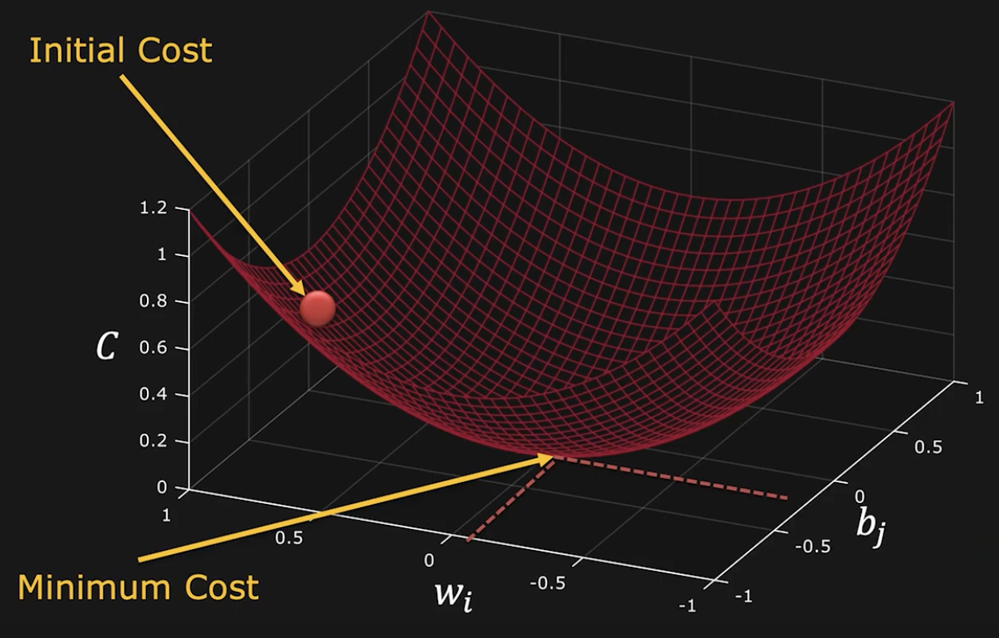

Gradient descent can ultimately point us in the right direction - guiding the cost "downhill" until the nearest minimum point is found. Once there, we also find the required weight and bias. Remember: cost is just basically the difference between the desired activation and the actual activation of the network with training data.

The derivative of a function is basically the slope of that funciton at a given point (where our "ball" is on the "cost function surface"). In 3D space, there's a slope in the x direction (or bias in the picture above) and also the y direction (weight). A negative slope indicates the function is going "downhill", so all gradient descent does is nudge the coordinates of our point of interest in the direction which the slope is most downhill, repeating the process until the slope zeroes out and likely is positive (uphill) in all directions: meaning the point of interest has reached the valley (and thus the cost is minimized).

However, let's back up and discuss the term *gradient*. The gradient is a way to package up the derivates associated with a function in a nice way. In our cost example, we have a function *f* with 2 independent variables (weight / bias), which we can for now just think of the classic *x & y*. From a typical calculus 3 course, we know that we can take partial derivatives of a funciton which will show us the change in one direction while holding the other constant. So for our function, f(x,y), we have a partial derivative of x, and a partial derivative of y.

The gradient, usually represented with a ∇ (nabla) symbol, is a ***vector valued function***. That means it is a vector which has coordinates that change based on the values of your variables (x and y in this example, but linear algebra students know this can go for higher dimensions). This may seem complex (it is), and I cannot do it justice with text alone, but I will try my best to provide examples.

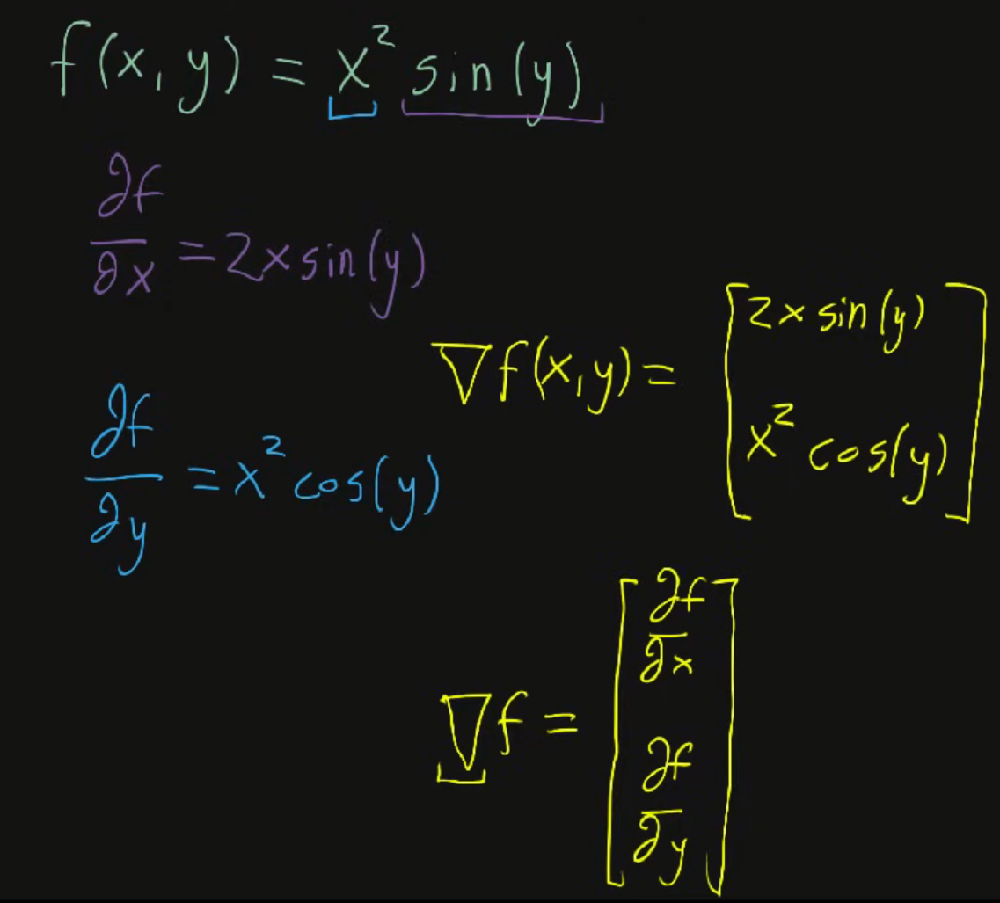

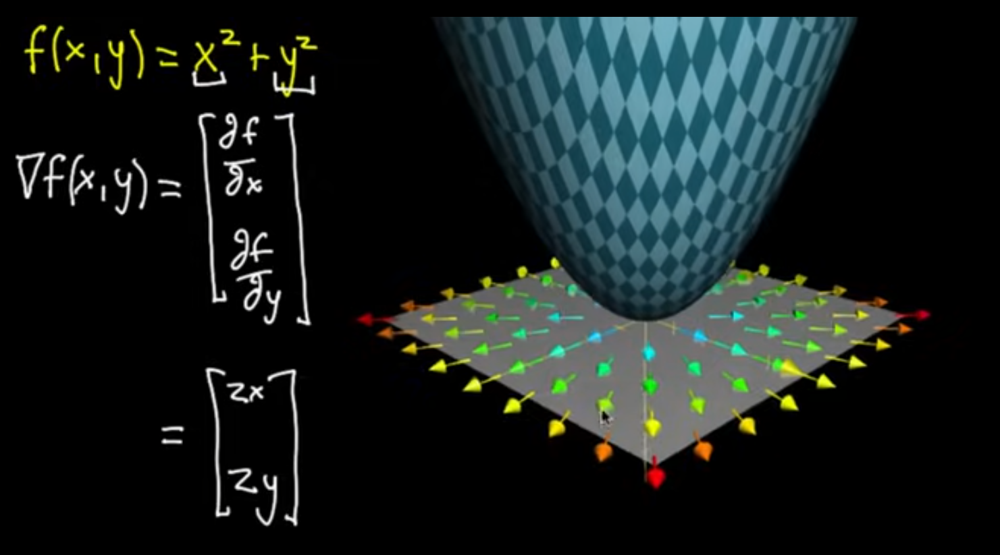

If you are confused, I cannot recommend the following enough:

[3blue1brown's Linear Algebra Series](https://www.youtube.com/playlist?list=PLZHQObOWTQDPD3MizzM2xVFitgF8hE_ab)

[Khan Academy's Gradient / Gradients & Graphs videos](https://www.khanacademy.org/math/multivariable-calculus/multivariable-derivatives/gradient-and-directional-derivatives/v/gradient)

So, to move things along, let's move onto gradient descent specifically. The intuition of gradient descent is to compute the gradient of our cost function, then step in the opposite direction of the gradient (due to the gradient indicating the direction in which the function's value increases the most). The amount we choose to step is called the *learning rate*. This is some percentage multiplied by the magnitude of the gradient vector. A large learning rate means you'll jump around quite a lot, a small learning rate means you'll take baby steps.

Let's back up for a second. I am not an expert on the subject, but after writing down some thoughts, using this idea of the cost function being some surface that a "ball rolls down", I came up with a sort of simple explanation.

First, let's start with the most simple case - one input into one neuron with one weight and one bias. Step one is to randomly assign the weight and bias. Let 𝒲 = 𝟷 and 𝛣 = 𝟸. Then we input our training data and it will output some number based on that neuron's activation function (let's use sigmoid). That value is compared to the desired output and the cost is computed as the difference between desired output and actual output. Let's imagine the cost of this first training example is 0.8. Obviously, we want to get this value to be as close to 0 as possible, but right now that's all we know about this example neuron. Let's graph this info as a point in 3D space, the x axis represents the weight value, y axis will be the bias, z axis the cost (1, 2, 0.8):

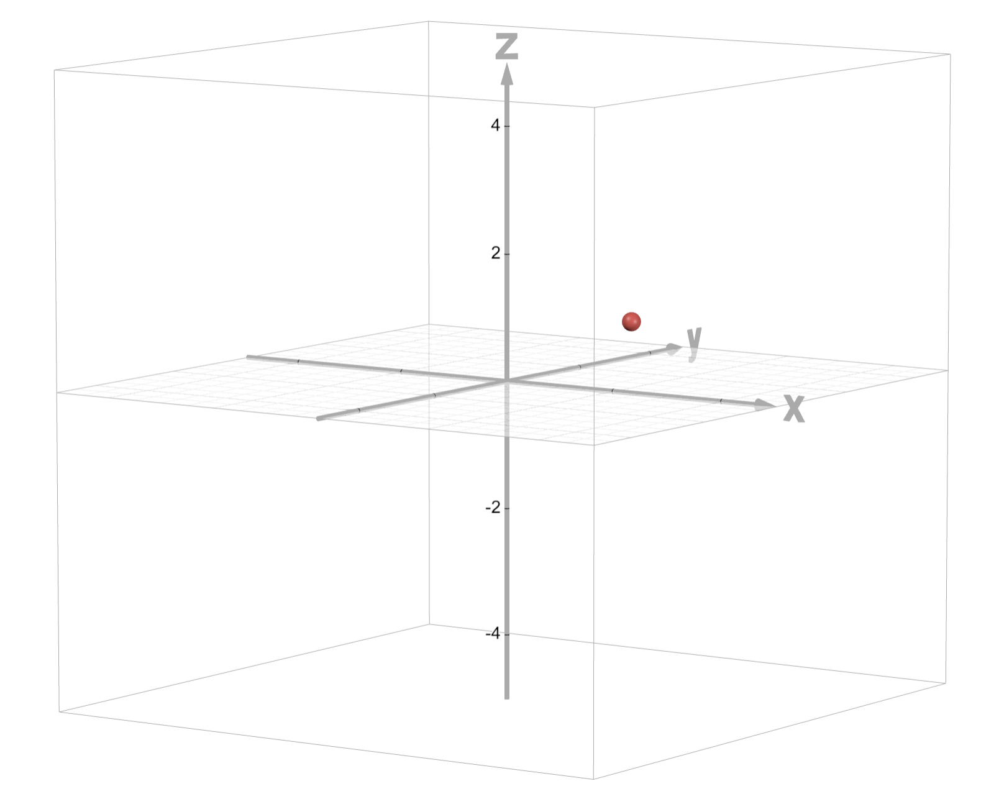

We know *nothing* about the cost function besides this one point, so to find more info, we will need to nudge the weight and bias a little bit to see how the cost changes. Let's set the weight (or x value of our point) to be 1.1 instead of 1. Next, we would re-compute the cost of the training input. Let's say this time the cost turns out to be 1.3 instead of 0.8. Plotting this new point (1.1, 2, 1.3):

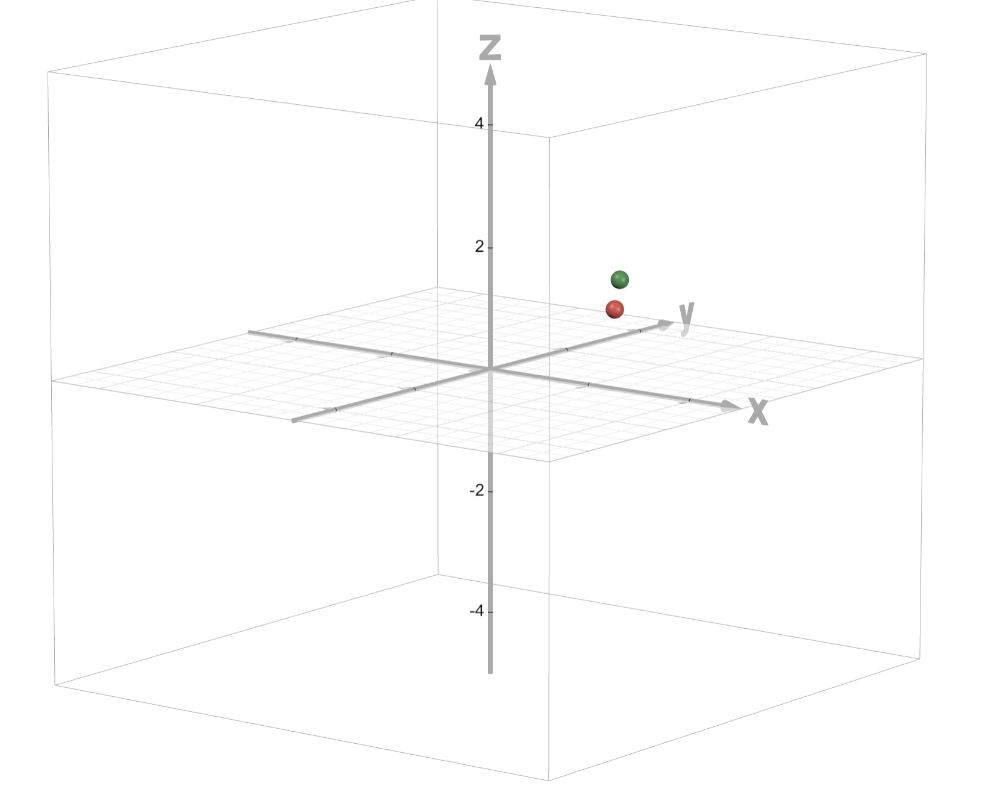





Remember, I am just making up some numbers here. Next, we need to nudge the bias, say 2.1 instead of 2. Re-computing the cost, let's say we get 0.6 on this run. Now we have 3 points to graph, the new point being at (1,2.1,0.6):

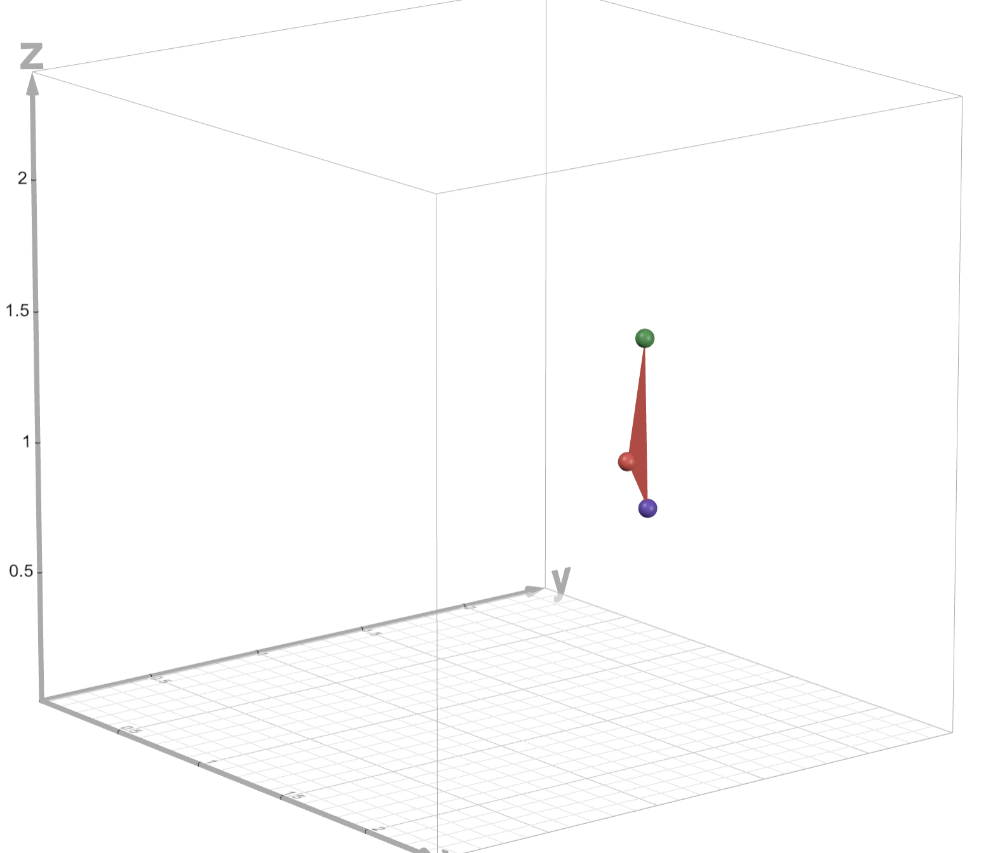

With all this information, we have the start of a cost function. It's a small triangle that slants in some direction - the gradient will tell us where that steepest slant is. Since we know how the function changes across each dimension, we can use gradient descent to step in the "downhill" direction, recomputing the cost and getting more info about our function (for example, we can just intuitively see that increasing the weight increases the cost, increasing the bias decreases the cost. A weight decrease and bias increase may bring our cost down even further, and the learning rate, η, would tell us by how much).

Unfortunately, there are two huge problems with this illustration. First, if there are a ton of neurons in the network (like 800 weights and biases), then the cost function "surface" is some 801 dimensional shape (impossible to visualize but mathematically it's computable). That requires a ton of individual nudges in each direction and is just a computing headache. Second, the idea of getting a gradient from just some points in space making some surface is tricky since we have no clue what the actual function is. Really, the idea of a gradient involves calculus on the actual function, so my illustration is not even accurate.

Anyway this is where **back propagation** comes to help. Backpropagation is pretty complex, and I feel that explaining it is better left to the professionals. There are countless papers on the subject, as well as youtube videos that explain backprop, see these videos: [one](https://www.youtube.com/watch?v=Ilg3gGewQ5U), [two (first 20 ish mins)](https://www.youtube.com/watch?v=dB-u77Y5a6A), [three](https://www.youtube.com/watch?v=8gFrim7cTzI).

With some of those done, here's a simple example I worked out with one neuron, weight and bias:

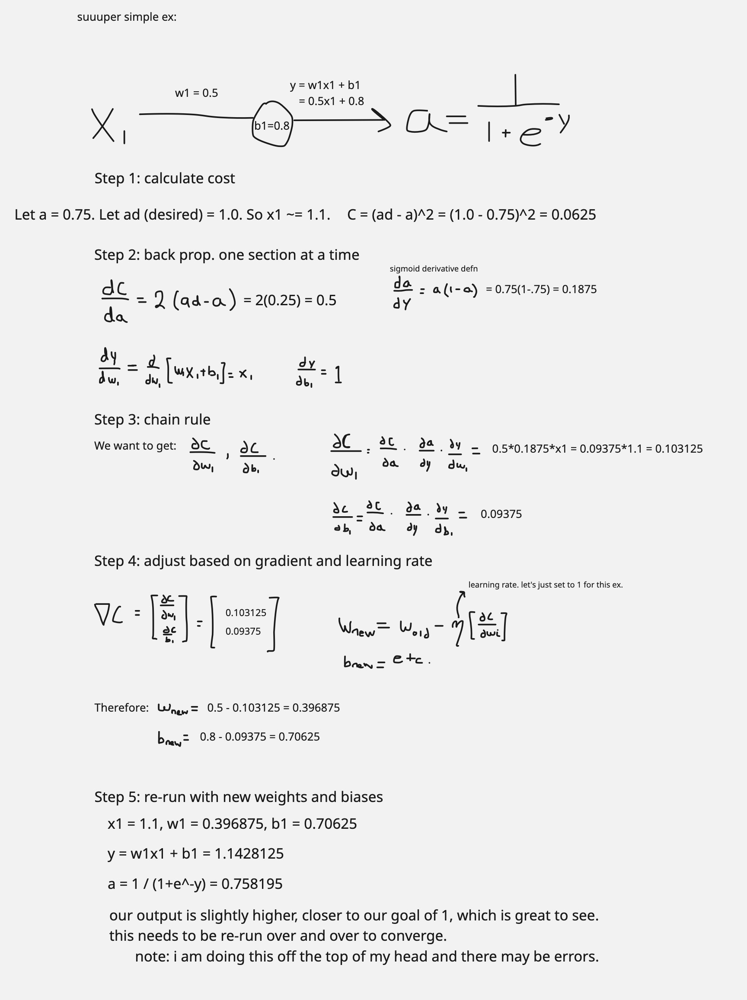

It took me days to somewhat wrap my head around backprop. and even then, I cannot fully understand it on a large scale (I read that backprop was a gradual build up of decades of research!). Regardless, we need to eventually just accept the fact that the developers of this concept were incredibly smart, and then work on figuring out how to code it (this is a python notebook after all). First, if curious, here's some more hand notes I took trying to generalize this process:

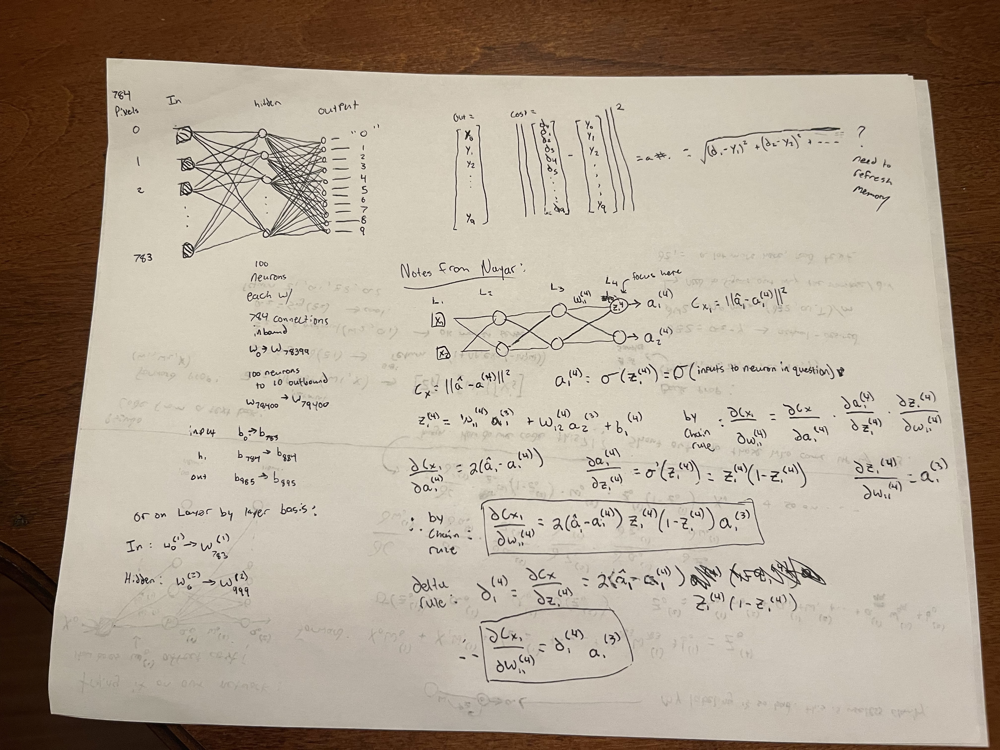

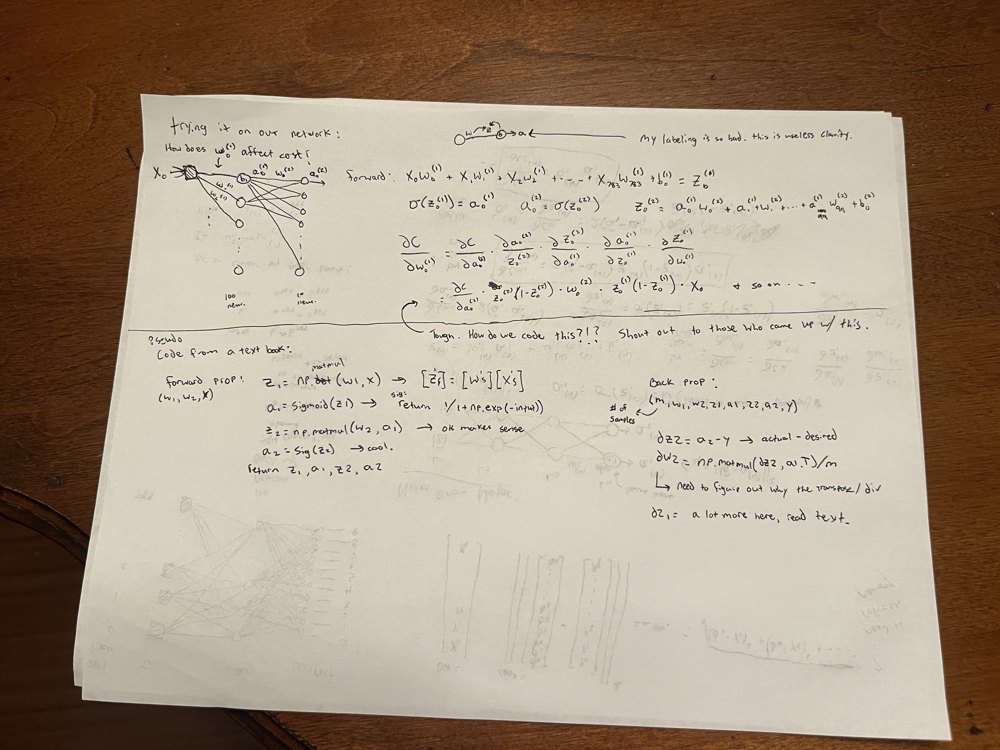

Let's start our coding with the MNIST dataset. I downloaded the CSV version from [here](https://www.kaggle.com/datasets/oddrationale/mnist-in-csv). The original dataset is just binary and we would have to parse the first 16 and 8 bytes of training and test data, blah blah. The CSV is easier to program with, at the cost of being a larger file. Each row consists of 785 values: the first value is the label (a number from 0 to 9) and the remaining 784 values are the pixel values (a number from 0 to 255).

 So the goals are: 1) read in the training data 2) construct and randomize the neural network 3) feed in training data and gradient descent with back prop 4) then input the test data and collect the outputs 5) compare our outputs to the test images' actual labels.

In [3]:
# A lot of pieces of this are taken from textbooks / online resources

import pandas as pd # CSV use
import numpy as np  # math use

# Load CSVs
train_df = pd.read_csv("mnist_train.csv")
test_df  = pd.read_csv("mnist_test.csv")

# Split up labels
training_labels = train_df.iloc[:, 0].values
training_inputs = train_df.iloc[:, 1:].values / 255.0  # Normalizing input values 0–255 to 0–1
testing_labels  = test_df.iloc[:, 0].values
testing_inputs  = test_df.iloc[:, 1:].values / 255.0

# Convert labels into 10-D vectors with all 0's except for the number it is
# Ex: label = 2 therefore output vector = [0,0,1,0,0,0...,0]
#                                digit:    0 1 2 3 4 5... 9
training_desired_output = np.eye(10)[training_labels]
testing_desired_output  = np.eye(10)[testing_labels]

# Printing our input vector shapes to make sure we are getting them all:
print(training_inputs.shape, testing_inputs.shape)

input_size = 784
hidden_size = 100
output_size = 10

# Network architecture shown in my drawing above

# Random initialization: I choose between -0.5 and 0.5 for a starting point
W1 = np.random.rand(input_size, hidden_size) - 0.5
b1 = np.random.rand(1, hidden_size) - 0.5
# W1: (784 x 100) connects input layer to hidden layer
# b1: (1 x 100) bias for each hidden layer neuron

W2 = np.random.rand(hidden_size, output_size) - 0.5
b2 = np.random.rand(1, output_size) - 0.5
# W2: (100 x 10) connects hidden layer to output layer
# b2: (1 x 10) bias for each output neuron

# Activation functions
def sigmoid(z):
    return 1 / (1 + np.exp(-z))

def sigmoid_deriv(a):
    return a * (1 - a)

def cost(y_true, y_pred):
    # Euclidian distance
    return np.sqrt(np.sum((y_true - y_pred) ** 2, axis=1)).mean()
    # using the .mean() because textbook did it

def forwardprop(X):
    # Hidden layer
    z1 = X @ W1 + b1  # The @ is matrix multiplication, using matricies let's us do everything at once
    a1 = sigmoid(z1)

    # Output layer
    z2 = a1 @ W2 + b2
    a2 = sigmoid(z2)
    return z1, a1, z2, a2

def backprop(X, y_true, z1, a1, z2, a2, learning_rate):
    global W1, b1, W2, b2 # Initialize variables (program errors otherwise)

    # dC/da2 for Euclidean distance
    da2 = a2 - y_true

    # Output layer
    dz2 = da2 * sigmoid_deriv(a2)
    dW2 = (a1.T @ dz2)
    # .T flips shape from (batch_size x neurons) to (neurons x batch_size)
    # so matrix multiplication matches the dimensions
    db2 = np.sum(dz2)

    # Hidden layer
    dz1 = (dz2 @ W2.T) * sigmoid_deriv(a1)  # again, we have to transpose to match dimensions.
    dW1 = (X.T @ dz1)
    db1 = np.sum(dz1)

    # Update parameters
    W1 -= learning_rate * dW1
    b1 -= learning_rate * db1
    W2 -= learning_rate * dW2
    b2 -= learning_rate * db2

# Ok time to loop and train:
# We are going to take training examples from the mnist_train csv, at random
# Randomizing gives the machine a better picture of the cost function.
# There's 60,000 training examples. That may be too many, ima do 10k.
# Note: I didn't cover batch gradient descent yet, see notes farther down.

subset_size = 10000
indices = np.random.choice(training_inputs.shape[0], subset_size, replace=False) # pick em at random
X_subset = training_inputs[indices]
y_subset = training_desired_output[indices]

epochs = 5  # we going to pass thru the training set 5 times
learning_rate = 0.1   # experiment with this of course

for epoch in range(epochs):
    # Shuffle subset each epoch for that nice randomness
    index = np.random.permutation(subset_size)
    X_subset = X_subset[index]
    y_subset = y_subset[index]

    for i in range(subset_size):
        x = X_subset[i].reshape(1, -1)      # shape must be (1, 784) for matrix mult.
        y = y_subset[i].reshape(1, -1)      # shape must be (1, 10) for matrix mult.

        z1, a1, z2, a2 = forwardprop(x)
        backprop(x, y, z1, a1, z2, a2, learning_rate)

    # Calculate cost
    _, _, _, a2_output = forwardprop(X_subset)
    cost_value = cost(y_subset, a2_output)
    print(f"Epoch {epoch+1}/{epochs} - Cost: {cost_value:.4f}")

# if everything looks good, lets test some! 10,000 test examples
# we will also keep track of how many we get wrong since label is included.

def test_accuracy(X_test, y_test_labels):
    _, _, _, a2_test = forwardprop(X_test)
    predictions = np.argmax(a2_test, axis=1)        # Predicted digit per example
    num_wrong = np.sum(predictions != y_test_labels)
    error_rate = num_wrong / len(y_test_labels)
    print(f"Test set errors: {num_wrong} / {len(y_test_labels)} ({error_rate:.2%} error rate)")

test_accuracy(testing_inputs, testing_labels)

(60000, 784) (10000, 784)
Epoch 1/5 - Cost: 0.3302
Epoch 2/5 - Cost: 0.2538
Epoch 3/5 - Cost: 0.2162
Epoch 4/5 - Cost: 0.1855
Epoch 5/5 - Cost: 0.1675
Test set errors: 664 / 10000 (6.64% error rate)


Hey look at that! We did it pretty well!

This project took me ***WEEKS***. More than I expected. I wanted to go deep into it. The programming part is tough, on paper it's not too hard to see how to do it, but translating those ideas into code is tough for sure. Very tedious. Yes, this is nothing new and in fact all of this code can be found online in resources (and is probably better than mine), but a lot of it is just code, not a deep look at ***why*** we are doing this stuff.

Further topics for you too look up:

1) Batch gradient descent

2) Convolutional Neural Networks

3) Transformers

To do in the future: make a program that lets you draw numbers with your mouse, then run that through the neural network after it's been trained (replacing the test data part).

Ok that's about it, if you got this far, thank you for reading my project. I hope it was easy to follow!

In [ ]:
pip install pygame

In [ ]:
import pygame
import numpy as np
import sys
from scipy.ndimage import zoom

# INSERT NEURAL NET CODE HERE

# Initialize pygame
pygame.init()
window_size = 280  # 10x MNIST size for easier drawing
screen = pygame.display.set_mode((window_size, window_size))
pygame.display.set_caption("Draw a digit (press SPACE to predict, ESC to quit)")

# Colors
WHITE = (255, 255, 255)
BLACK = (0, 0, 0)

# Clear screen to white
screen.fill(WHITE)
pygame.display.update()

drawing = False
brush_size = 15

def preprocess(surface):
    # Get pixel array from pygame surface
    data = pygame.surfarray.array3d(surface)
    # Convert to grayscale by averaging RGB channels
    gray = np.dot(data[..., :3], [0.2989, 0.5870, 0.1140])
    # Flip axes to match MNIST orientation (optional, test if needed)
    gray = np.flipud(gray.T)
    # Resize from 280x280 to 28x28 using scipy zoom
    small = zoom(gray, 28/gray.shape[0])
    # Normalize and invert colors (MNIST digits are white on black)
    small = (255 - small) / 255.0
    return small.reshape(1, -1)  # shape (1, 784)

def predict_digit(img_vector):
    _, _, _, output = forwardprop(img_vector)
    pred = np.argmax(output)
    print(f"Prediction: {pred}")

running = True
while running:
    for event in pygame.event.get():
        if event.type == pygame.QUIT:
            running = False

        elif event.type == pygame.MOUSEBUTTONDOWN:
            drawing = True

        elif event.type == pygame.MOUSEBUTTONUP:
            drawing = False

        elif event.type == pygame.KEYDOWN:
            if event.key == pygame.K_ESCAPE:
                running = False
            elif event.key == pygame.K_SPACE:
                # Predict on current drawing
                img_vec = preprocess(screen)
                predict_digit(img_vec)
            elif event.key == pygame.K_c:
                # Clear screen on 'c'
                screen.fill(WHITE)
                pygame.display.update()

    if drawing:
        pos = pygame.mouse.get_pos()
        pygame.draw.circle(screen, BLACK, pos, brush_size)
        pygame.display.update()

pygame.quit()
sys.exit()

Upon running the full code and drawing my own digits in, it said my "3" was a "5" so yeah, far from perfect. Of course, more epochs will fine tune those weights more etc. etc.

Also look up pytorch / tensor flow. I think they just do all this for you. But here we started from scratch!